# Import Libraries 

In [1]:
# What version of Python do you have?
import sys

import tensorflow.keras
import pandas as pd
import sklearn as sk
import tensorflow as tf

print(f"Tensor Flow Version: {tf.__version__}")
print(f"Keras Version: {tensorflow.keras.__version__}")
print()
print(f"Python {sys.version}")
print(f"Pandas {pd.__version__}")
print(f"Scikit-Learn {sk.__version__}")
gpu = len(tf.config.list_physical_devices('GPU'))>0
print("GPU is", "available" if gpu else "NOT AVAILABLE")

Tensor Flow Version: 2.1.0
Keras Version: 2.2.4-tf

Python 3.7.13 (default, Mar 28 2022, 08:03:21) [MSC v.1916 64 bit (AMD64)]
Pandas 1.3.4
Scikit-Learn 1.0.2
GPU is available


In [2]:
import numpy as np 
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Activation, Dense, Flatten, BatchNormalization, Conv2D, MaxPooling2D, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras import utils
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.datasets import mnist
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.applications.mobilenet_v2 import  MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import classification_report,confusion_matrix
import datetime
import itertools
import os
import cv2
import shutil
import random
import glob
import matplotlib.pyplot as plt
import warnings 
from sklearn.utils import shuffle
warnings.simplefilter(action= 'ignore', category=FutureWarning)
%matplotlib inline

pd.set_option('display.max_rows', 15)  # or 1000

# Load image 

In [3]:
train_path = '../data/dataset_unbalanced/train/'
test_path = '../data/dataset_unbalanced/val/'

In [4]:
folders = glob.glob(train_path + '*')

train_list = pd.DataFrame(glob.glob(train_path + '*')).rename(columns = {0: 'name'})
# generate ordinal categories for y

train_list['class_name'] = train_list.name.apply(lambda x: x.split("\\")[1])

classes = train_list['class_name'].unique().tolist()
print(f'Number of classes: {len(classes)}')

Number of classes: 22


In [5]:
train_dataset = ImageDataGenerator(
    rescale = 1./225,
    horizontal_flip = True,
    vertical_flip = True,
    shear_range = 20,
    brightness_range = [0.6,1.2],
).flow_from_directory(directory = train_path, target_size = (224,224), class_mode = 'categorical', batch_size = 32,shuffle=False)

validation_dataset = ImageDataGenerator(
    rescale = 1./225,
).flow_from_directory(directory = test_path, target_size = (224,224), class_mode = 'categorical',batch_size = 32, shuffle=False)

Found 52090 images belonging to 22 classes.
Found 10443 images belonging to 22 classes.


In [6]:
class_dict=validation_dataset.class_indices
labels= validation_dataset.labels
file_names= validation_dataset.filenames

In [7]:
labels.shape

(10443,)

# Functions for better visualizations

In [8]:
# Defining a function to plot the confusion matrix in a grid for easier visualization.

def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion Matrix', export_as='confusion_matrix', cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    # print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=16)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True labels', fontsize=14)
    plt.xlabel('Predicted labels', fontsize=14)

In [9]:
# define function that gives us dataframe of confusion matrix, and worst class based on 'precision'

def get_classification_values_df(classification):
    # create df for classification reports split by spaces 
    df = pd.DataFrame(classification.split("\n"))

    # make df that only contains classes and values for precision, recall, f1-score and support score
    df = pd.DataFrame(df[0].apply(lambda x: x.split()).tolist()).rename(columns = {
        0: 'Name', 1: 'precision', 2: 'recall', 3: 'f1-score', 4: 'support'
        }).drop(columns = 5).drop(index = [0,1,24,25,26,27,28]).reset_index().drop(columns = 'index')

    # sort by recall, with the lowest first
    df = df.sort_values(by = 'precision', ascending = True)

    return df, df['Name'].iloc[0:1].values[0]

In [10]:
# create dataframe of prediction vs actual images (filtered based on worst class)

def create_prediction_df(pred, failed_class):
    # creating list for predictions and actual Y
    label_map = (train_dataset.class_indices)
    label_map = dict((v,k) for k,v in label_map.items())                      #flip k,v              

    predictions = [label_map[k] for k in pred]                                # to create list for predictions 
    label_class = [label_map[k] for k in labels]                              # to create list for labels 

    df = pd.DataFrame(list(zip(label_class, predictions, file_names)),        # to create df for all predictions 
               columns =['actual_y', 'pred', 'names'])

    print(f'Top wrong predictions of {failed_class}')
    print(df[(df['pred'] == failed_class) & (df['actual_y'] != failed_class)].actual_y.value_counts())

    df = df[(df['actual_y'] != failed_class) & (df['pred'] == failed_class)]
    
    return df

In [11]:
# create dataframe that shows predictions vs actual images (without filters)
def create_df_nofilter(pred):
    # creating list for predictions and actual Y
    label_map = (train_dataset.class_indices)
    label_map = dict((v,k) for k,v in label_map.items())                      #flip k,v              

    predictions = [label_map[k] for k in pred]                                # to create list for predictions 
    label_class = [label_map[k] for k in labels]                              # to create list for labels 

    df = pd.DataFrame(list(zip(label_class, predictions, file_names)),        # to create df for all predictions 
               columns =['actual_y', 'pred', 'names'])
    
    return df

In [12]:
# defines function that takes in model and come out with prediction 
# uses prediction and create dataframe that contains the comparison between actual and predicted classes. 
# Function gives output of 
# 1) Classification score dataframe
# 2) Dataframe for worst class based on `precision`
# 3) Worst class by string 
# 4) Dataframe which is unfiltered 

def generate_df(model, fail_class = None, norm = True):
    # Generating predictions from the model above.
    pred = model.predict(validation_dataset)
    pred = pred.argmax(axis=-1)

    # plot confusion matrix 
    cm = confusion_matrix(labels, pred)
    plt.figure(figsize=(20,10))
    plot_confusion_matrix(cm, classes, normalize= norm, title = 'Confusion Matrix')
    plt.show()
    
    # generate classification report
    raw_report = classification_report(labels, pred, target_names=class_dict.keys())
    print('Classification Report')
    
    # get df for classification out and get worst performing class based on 'precision'
    df_classification, class_fail = get_classification_values_df(raw_report)
    print(df_classification)
    print('\n')

    if fail_class ==None:
        # create df with actual and predicted value 
        # get value counts for worst performing class only. 
        df_worst_class = create_prediction_df(pred, class_fail)
        print(f'Worst Performing Class: {class_fail}')

    else:
        # create df with actual and predicted value 
        # get value counts for worst performing class only. 
        df_worst_class = create_prediction_df(pred, fail_class)
        print(f'Worst Performing Class: {fail_class}')

    unfiltered_df = create_df_nofilter(pred)

    return df_classification, df_worst_class, class_fail, unfiltered_df

In [13]:
# create dataframe for unique sample list
# this dataframe will be used for sample predicted images (supposed images model thinks it is correct)

unique_vege_list = pd.DataFrame([classes, glob.glob('../data/unique_images/*')]).T.rename(columns = {0: 'Name', 1: 'dir'})

In [14]:
unique_vege_list.Name = unique_vege_list.Name.apply(lambda x:x.lower())

unique_vege_list.to_csv('../logs/checkpoint/unique_vegetable_list.csv')

In [15]:
unique_vege_list

,Name,dir
0,baby_chyesim,../data/unique_images\baby_chyesim.JPG
1,bean,../data/unique_images\beans.jpg
2,bitter_gourd,../data/unique_images\bitter_gourd.jpg
3,bottle_gourd,../data/unique_images\bottle_gourd.jpg
4,brinjal,../data/unique_images\brinjal.jpg
...,...,...
17,potato,../data/unique_images\potato.jpg
18,pumpkin,../data/unique_images\pumpkin.jpg
19,radish,../data/unique_images\radish.jpg
20,sharp_spinach,../data/unique_images\sharp_spinach.JPG


In [16]:
# defines function that plots wrongly classified images based on predicted image 
# Function outputs: 
# 1_Series of wrongly predicted images (actual images)
# 2_Predicted image of predicted class (predicted)
def wrong_prediction_plotter(ds, predicted):
    print("Predicted as {}:".format(predicted));
    n = len(ds)
    if n == 0:
        print("No pictures wrongly predicted as {}".format(predicted))
    else:
        ncols = 7
        nrows = int(np.ceil(n/7))
        fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(3*ncols, 3*nrows), frameon=False)
        axs=axs.ravel()
        # for each wrong classes, each images will be read and plotted. 
        for i, index in enumerate(ds.index):
            img = cv2.imread(str('../data/dataset_unbalanced/val/'+ ds['names'][index]))
            recolored_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)	#convert from BGR format to RGB format
            resized_img = cv2.resize(recolored_img, (224,224))
            axs[i].imshow(resized_img)
            axs[i].set_title('Actual: ' + ds['actual_y'][index]);

        for ax in axs:
            ax.axis('off');

        plt.show()


    # Plot one photo of what model thinkgs is correct
    pred_dir = unique_vege_list[unique_vege_list['Name'] == predicted.lower()].dir.values[0]
    img = cv2.imread(str(pred_dir))
    recolored_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)	#convert from BGR format to RGB format
    resized_img = cv2.resize(recolored_img, (224,224))

    plt.figure(figsize=(3,3))
    plt.imshow(resized_img),
    plt.title('Predicted Image: ' + predicted);
    plt.axis('off')

In [45]:
# define function that plots feature maps according to what layer you want to specify and inspect 

def plot_feature_maps(dir, model, list_of_layers, scale_factor, color):
    img_path=dir
    # Define a new Model, Input= image 
    # Output= intermediate representations for all layers in the  
    # previous model after the first.
    successive_outputs = [layer.output for layer in model.layers[1:]]
    #visualization_model = Model(img_input, successive_outputs)
    visualization_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)
    #Load the input image
    img = load_img(img_path, target_size=(224, 224))  
    # Convert ht image to Array of dimension (150,150,3)
    x   = img_to_array(img)                    
    x   = x.reshape((1,) + x.shape)                   
    # Rescale by 1/255
    x /= 255.0
    # Let's run input image through our vislauization network
    # to obtain all intermediate representations for the image.
    successive_feature_maps = visualization_model.predict(x)
    # Retrieve are the names of the layers, so can have them as part of our plot
    layer_names = [layer.name for layer in model.layers]

    for layer_name, feature_map in zip(layer_names, successive_feature_maps):
    # print(feature_map.shape)

        # Choose filter layers you want to see. Dont load everything as it will cause computer to crash
        filter_list = list_of_layers
        for filter in filter_list:
            if (filter in layer_name):

                # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
            
                n_features = feature_map.shape[-1]  # number of features in the feature map
                size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
                
                # We will tile our images in this matrix
                display_grid = np.zeros((size, size * n_features))
                
                # Postprocess the feature to be visually palatable
                for i in range(n_features):
                    x  = feature_map[0, :, :, i]
                    x -= x.mean()
                    x /= x.std ()
                    x *=  64
                    x += 128
                    x  = np.clip(x, 0, 255).astype('uint8')
                    # Tile each filter into a horizontal grid
                    display_grid[:, i * size : (i + 1) * size] = x 

                # Display the grid
                scale = scale_factor / n_features
                plt.figure( figsize=(scale * n_features, scale) )
                plt.title ( layer_name )
                plt.grid  ( False )
                plt.imshow( display_grid, aspect='auto', cmap=color)

# Load Models

1) MobileNetV2 - Pre-trained model
2) MobilenetV2 - Complete Re-training + Fine tuning
3) VGG16 - Pre-training model + Fine tuning

## Load pre-trained MobileNetV2

In [17]:
# define function that creats mobileNetV2 
def create_mobilenet():
    image_size = [224,224]
    #instantiate transfer learning wihtout including top layer
    mobilenetv2 = MobileNetV2(input_shape= image_size + [3], weights = 'imagenet', include_top = False)

    # Freeze all layers first
    mobilenetv2.trainable = False 

    # initial layers 
    x = tf.keras.layers.GlobalAveragePooling2D()(mobilenetv2.output)
    x = tf.keras.layers.Reshape((1, 1, 1280))(x)
    x = tf.keras.layers.Dropout(0.3, name='Dropout')(x)
    x = tf.keras.layers.Conv2D(len(folders), (1, 1), padding='same')(x)
    x = tf.keras.layers.Activation('softmax', name='final_activation')(x)
    prediction = tf.keras.layers.Reshape((len(folders),), name='output')(x)
   
    # create a model object 
    model_mobilenet = Model(inputs = mobilenetv2.input, outputs = prediction)
    
    # Compile model
    model_mobilenet.compile(loss='categorical_crossentropy',
                        optimizer='adam',
                        metrics=['accuracy'])

    return model_mobilenet

In [18]:
mobilenet_test_pretrained = create_mobilenet()
mobilenet_test_pretrained.load_weights('../code/training_mobilenet/cp-0015.ckpt')

In [19]:
mobilenet_test_pretrained.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
______________________________________________________________________________________________

## Load MobileNetV2 Complete Re-training

In [20]:
# Recreate VGG Model
mobilenet_unfrozen = tf.keras.models.load_model('../models/unfrozen_mobilenet_finetuned.h5')

## Load VGG16 Model 

In [21]:
# Recreate VGG Model
VGG_model = tf.keras.models.load_model('../models/VGG_model_finetuned.h5')

## Load CNN self-built Model 

In [22]:
# Recreate VGG Model
CNN_model = tf.keras.models.load_model('../models/CNN_model.h5')

# Base Model Performance

## Confusion Matrix 

Confusion matrix, without normalization


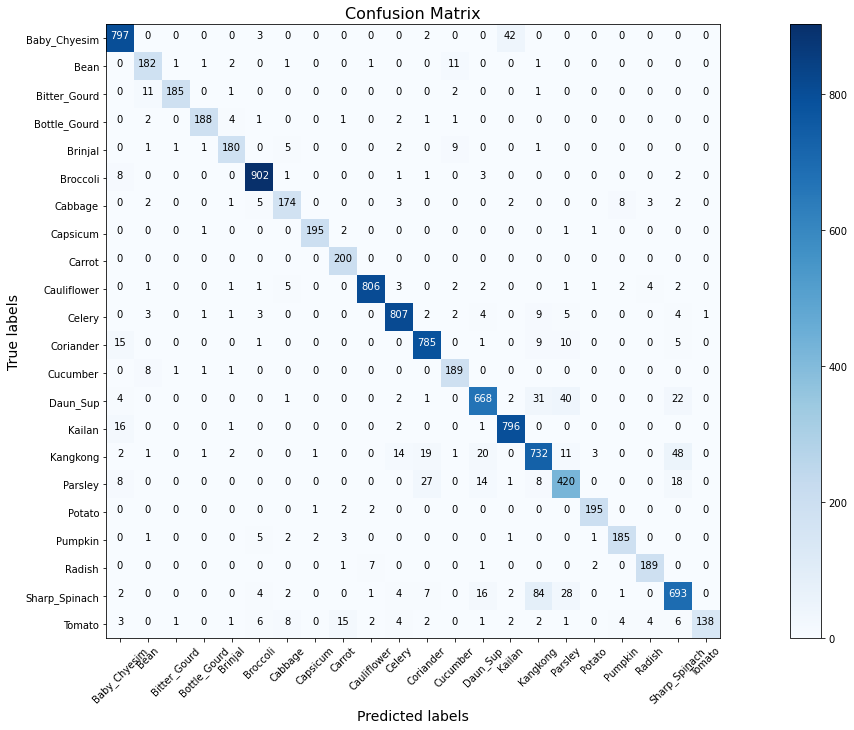

Classification Report
             Name precision recall f1-score support
16        Parsley      0.81   0.85     0.83     496
15       Kangkong      0.83   0.86     0.84     855
1            Bean      0.86   0.91     0.88     200
20  Sharp_Spinach      0.86   0.82     0.84     844
6         Cabbage      0.87   0.87     0.87     200
..            ...       ...    ...      ...     ...
3    Bottle_Gourd      0.97   0.94     0.95     200
7        Capsicum      0.98   0.97     0.98     200
2    Bitter_Gourd      0.98   0.93     0.95     200
9     Cauliflower      0.98   0.97     0.98     831
21         Tomato      0.99   0.69     0.81     200

[22 rows x 5 columns]


Top wrong predictions of Parsley
Daun_Sup         40
Sharp_Spinach    28
Kangkong         11
Coriander        10
Celery            5
Capsicum          1
Cauliflower       1
Tomato            1
Name: actual_y, dtype: int64
Worst Performing Class: Parsley


In [ ]:
df_classification_CNN, df_worst_class_CNN, class_fail_CNN, unfiltered_df_CNN = generate_df(CNN_model, norm = False)

Predicted as Parsley:


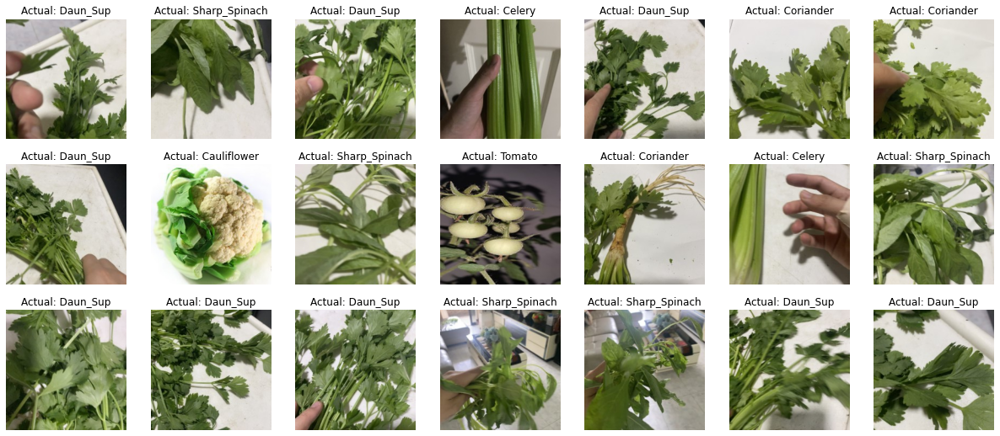

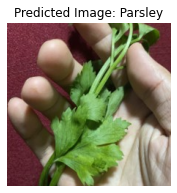

In [ ]:
# Show pictures of wrongly predicted class for CNN model
wrong_prediction_plotter(shuffle(df_worst_class_CNN)[:21], 'Parsley')

Predicted as Kailan:


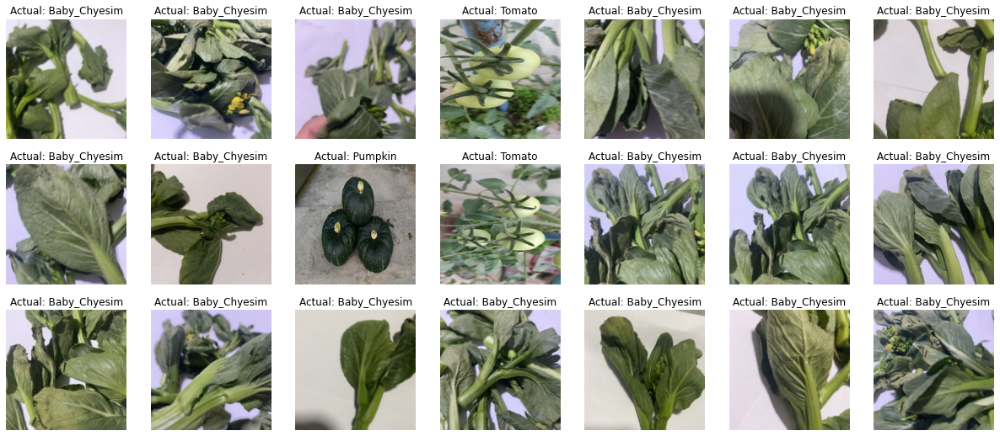

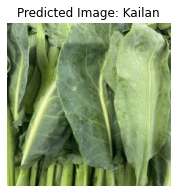

In [ ]:
# create another df for wrong classification of kailan
df = unfiltered_df_CNN[(unfiltered_df_CNN['actual_y'] != 'Kailan') & (unfiltered_df_CNN['pred'] == 'Kailan')]

# Show pictures of wrongly predicted class for CNN model
wrong_prediction_plotter(shuffle(df)[:21], 'Kailan')

Predicted as Carrot:


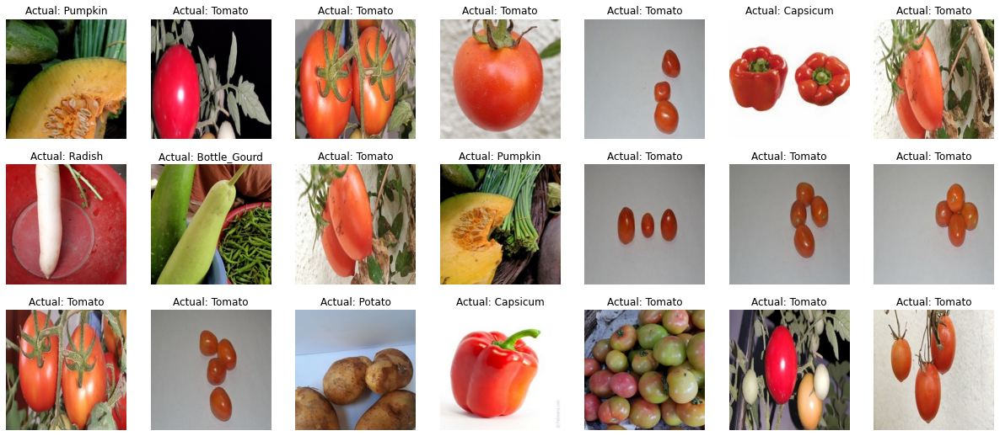

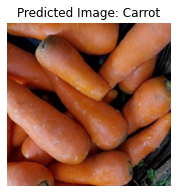

In [ ]:
# create another df for wrong classification of Carrot
df = unfiltered_df_CNN[(unfiltered_df_CNN['actual_y'] != 'Carrot') & (unfiltered_df_CNN['pred'] == 'Carrot')]

# Show pictures of wrongly predicted class for CNN model
wrong_prediction_plotter(shuffle(df)[:21], 'Carrot')

# MobileNetV2 with Pretrained weights VS Complete re-training

## Confusion Matrix 

### MobileNetV2 With Pre-trained weights 

Loading confusion matrix for pretrained MobileNetV2 

Confusion matrix, without normalization


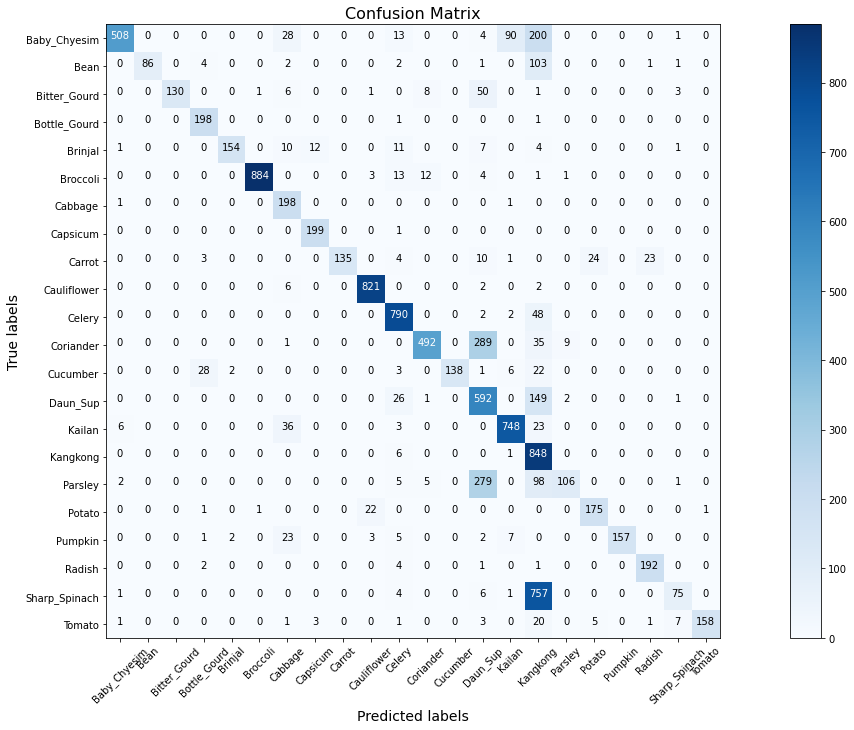

Classification Report
             Name precision recall f1-score support
15       Kangkong      0.37   0.99     0.54     855
13       Daun_Sup      0.47   0.77     0.58     771
6         Cabbage      0.64   0.99     0.77     200
20  Sharp_Spinach      0.83   0.09     0.16     844
3    Bottle_Gourd      0.84   0.99     0.91     200
..            ...       ...    ...      ...     ...
5        Broccoli      1.00   0.96     0.98     918
2    Bitter_Gourd      1.00   0.65     0.79     200
18        Pumpkin      1.00   0.79     0.88     200
1            Bean      1.00   0.43     0.60     200
12       Cucumber      1.00   0.69     0.82     200

[22 rows x 5 columns]


Top wrong predictions of Kangkong
Sharp_Spinach    757
Baby_Chyesim     200
Daun_Sup         149
Bean             103
Parsley           98
                ... 
Cauliflower        2
Bitter_Gourd       1
Bottle_Gourd       1
Broccoli           1
Radish             1
Name: actual_y, Length: 16, dtype: int64
Worst Performing Class:

In [ ]:
# create dataframe of predictions for MobileNetV2 with pretrained weights 
df_classification_pretrained, df_worst_class_pretrained, class_fail_pretrained, unfiltered_df_pretrained = generate_df(mobilenet_test_pretrained, norm = False)

Kangkong is mostly wrongly predicted on Sharp spinach. This is because of its similar length and size of its stems

Predicted as Kangkong:


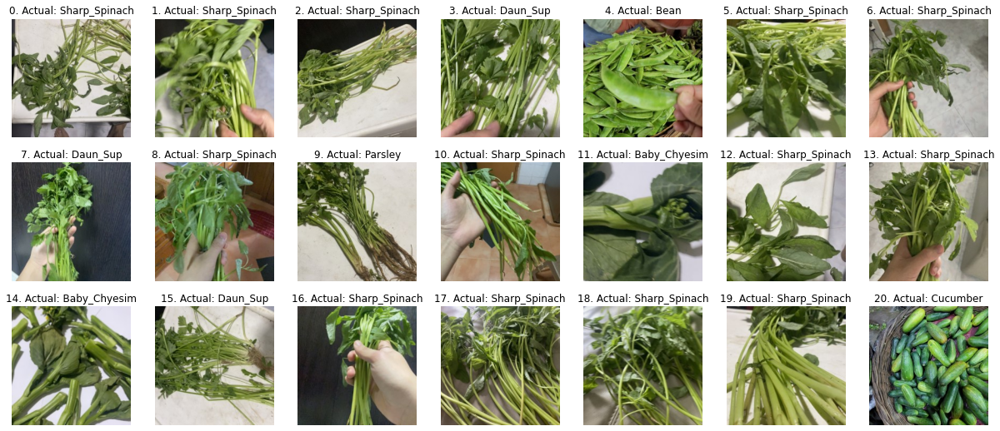

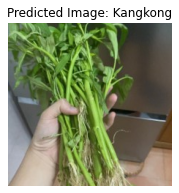

In [ ]:
# Show pictures of wrongly predicted class for MobileNetV2 pretrained model
wrong_prediction_plotter(shuffle(df_worst_class_pretrained)[:21], 'Kangkong')

### MobileNetV2 with Complete retraining 

Confusion matrix, without normalization


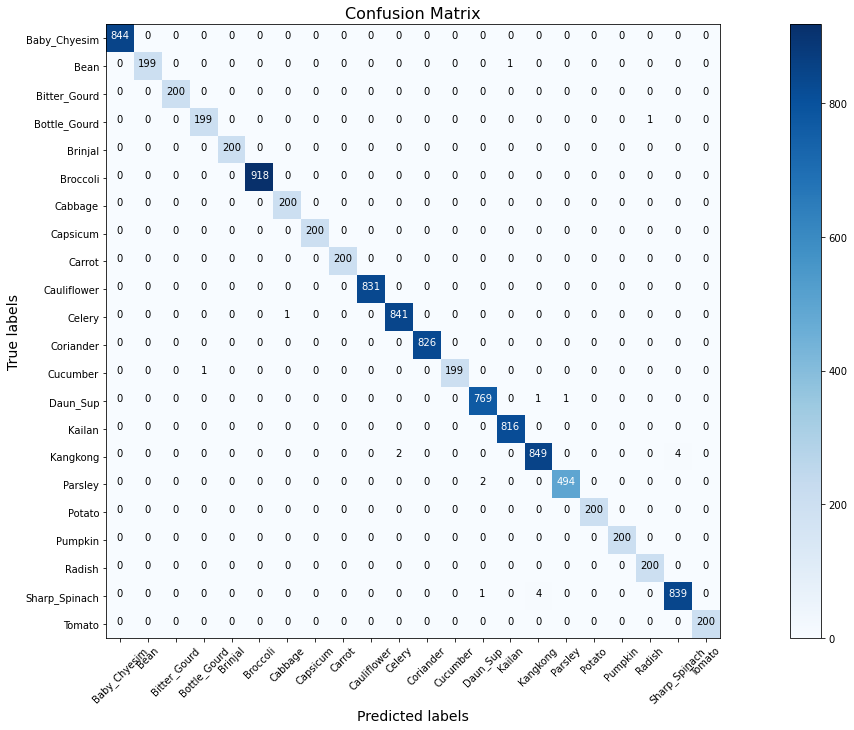

Classification Report
             Name precision recall f1-score support
3    Bottle_Gourd      0.99   0.99     0.99     200
15       Kangkong      0.99   0.99     0.99     855
0    Baby_Chyesim      1.00   1.00     1.00     844
19         Radish      1.00   1.00     1.00     200
18        Pumpkin      1.00   1.00     1.00     200
..            ...       ...    ...      ...     ...
4         Brinjal      1.00   1.00     1.00     200
2    Bitter_Gourd      1.00   1.00     1.00     200
1            Bean      1.00   0.99     1.00     200
20  Sharp_Spinach      1.00   0.99     0.99     844
21         Tomato      1.00   1.00     1.00     200

[22 rows x 5 columns]


Top wrong predictions of Bottle_Gourd
Cucumber    1
Name: actual_y, dtype: int64
Worst Performing Class: Bottle_Gourd


In [ ]:
# generate dataframe for MobileNetV2 with Complete retraining 
df_classification_unfrozen, df_worst_class_unfrozen, class_unfrozen, unfiltered_df_unfrozen = generate_df(mobilenet_unfrozen, norm = False)

Worst performing class: Bottle_Gourd | Kangkong

We will look into Kangkong since we have many vegetables misclassified

In [ ]:
df_unfrozen = unfiltered_df_unfrozen[(unfiltered_df_unfrozen['actual_y'] != 'Kangkong') & (unfiltered_df_unfrozen['pred'] == 'Kangkong')]

Predicted as Kangkong:


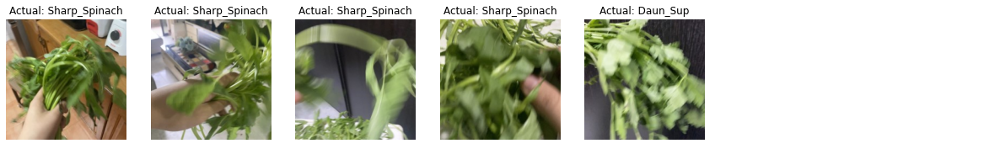

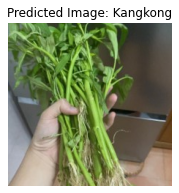

In [ ]:
# Show pictures of wrongly predicted class for MobileNetV2 pretrained model
wrong_prediction_plotter(shuffle(df_unfrozen), 'Kangkong')

We can see that most images taken were blur, which likely makes the model only capturing generalised pictures hence giving wrong predictions, which is in this case, the shape of the stems.

Predicted as Bottle_Gourd:


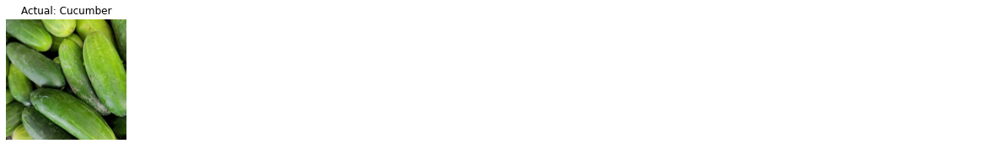

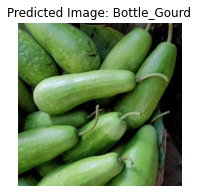

In [ ]:
# create another df for wrong classification of Bottle_Gourd
df = unfiltered_df_unfrozen[(unfiltered_df_unfrozen['actual_y'] != 'Bottle_Gourd') & (unfiltered_df_unfrozen['pred'] == 'Bottle_Gourd')]

# Show pictures of wrongly predicted class for CNN model
wrong_prediction_plotter(shuffle(df)[:21], 'Bottle_Gourd')

Predicted as Daun_Sup:


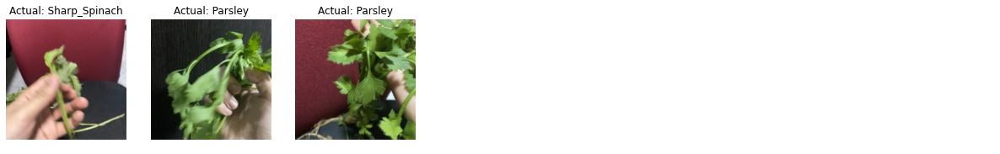

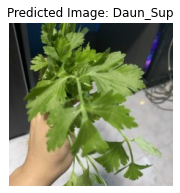

In [ ]:
# create another df for wrong classification of Daun_Sup
df = unfiltered_df_unfrozen[(unfiltered_df_unfrozen['actual_y'] != 'Daun_Sup') & (unfiltered_df_unfrozen['pred'] == 'Daun_Sup')]

# Show pictures of wrongly predicted class for CNN model
wrong_prediction_plotter(shuffle(df)[:21], 'Daun_Sup')

# VGG16 Performance

## Confusion Matrix

Confusion matrix, without normalization


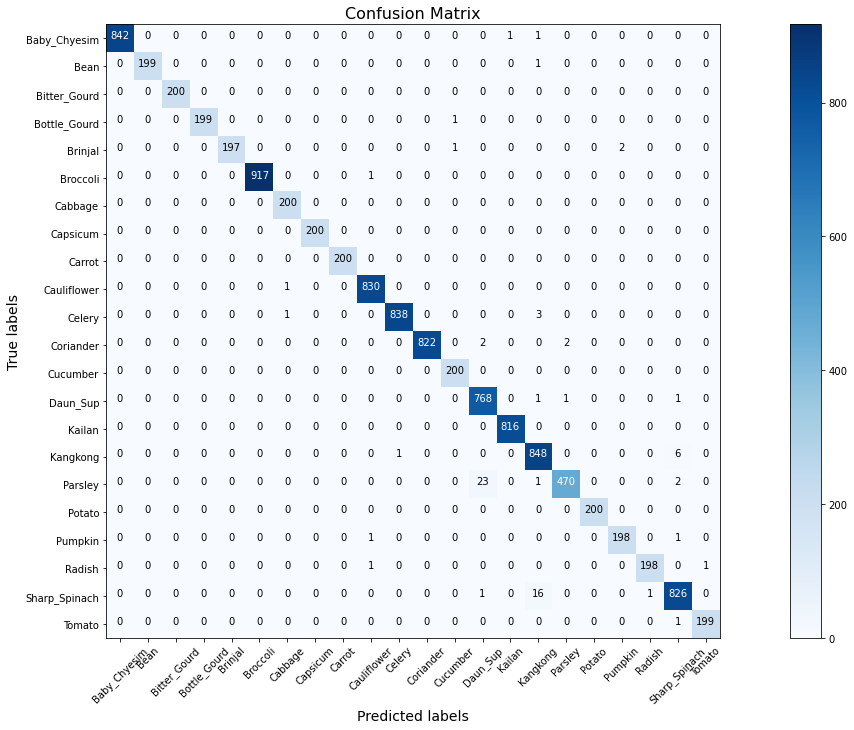

Classification Report
            Name precision recall f1-score support
15      Kangkong      0.97   0.99     0.98     855
13      Daun_Sup      0.97   1.00     0.98     771
21        Tomato      0.99   0.99     0.99     200
19        Radish      0.99   0.99     0.99     200
18       Pumpkin      0.99   0.99     0.99     200
..           ...       ...    ...      ...     ...
3   Bottle_Gourd      1.00   0.99     1.00     200
2   Bitter_Gourd      1.00   1.00     1.00     200
1           Bean      1.00   0.99     1.00     200
11     Coriander      1.00   1.00     1.00     826
10        Celery      1.00   1.00     1.00     842

[22 rows x 5 columns]


Top wrong predictions of Kangkong
Sharp_Spinach    16
Celery            3
Baby_Chyesim      1
Bean              1
Daun_Sup          1
Parsley           1
Name: actual_y, dtype: int64
Worst Performing Class: Kangkong


In [ ]:
# Generate dataframe of predictions from VGG16 
df_classification_vgg16, df_worst_class_vgg16, class_fail_vgg16, unfiltered_df_vgg16  = generate_df(VGG_model, norm = False)

Worst class in terms of precision coming from Kangkong

Predicted as Kangkong:


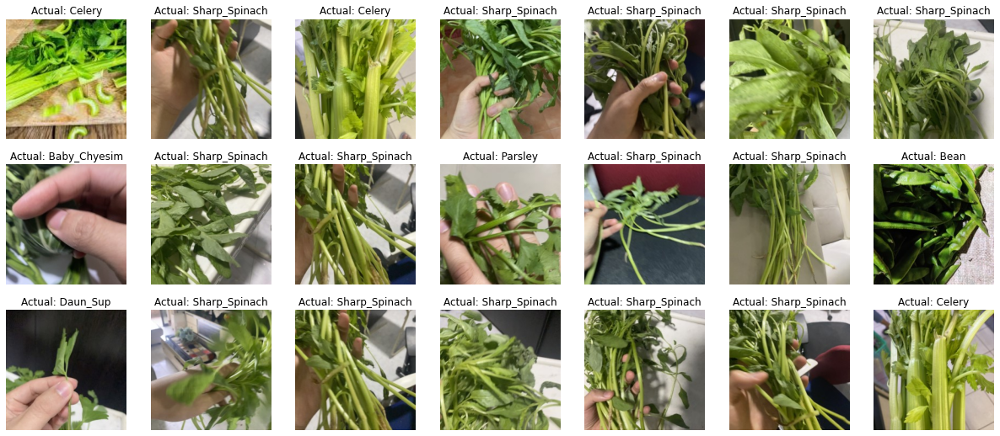

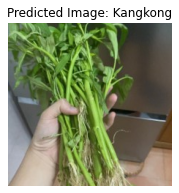

In [ ]:
# Show pictures of wrongly predicted class for VGG16 model
wrong_prediction_plotter(shuffle(df_worst_class_vgg16)[:21], 'Kangkong')

Predicted as Parsley:


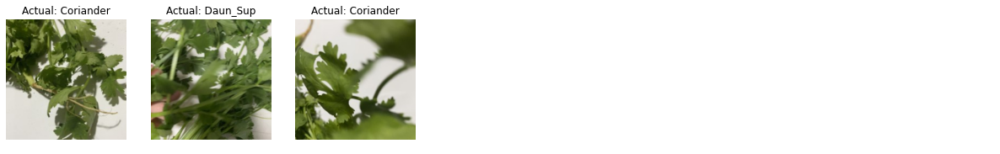

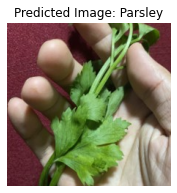

In [ ]:
# create another df for wrong classification of Parsley
df = unfiltered_df_vgg16[(unfiltered_df_vgg16['actual_y'] != 'Parsley') & (unfiltered_df_vgg16['pred'] == 'Parsley')]

# Show pictures of wrongly predicted class for CNN model
wrong_prediction_plotter(shuffle(df)[:21], 'Parsley')

The shape of parsley may not be captured optimally at that particular instance to capture enough details to distinguish between daun sup and parsley. 

Predicted as Cucumber:


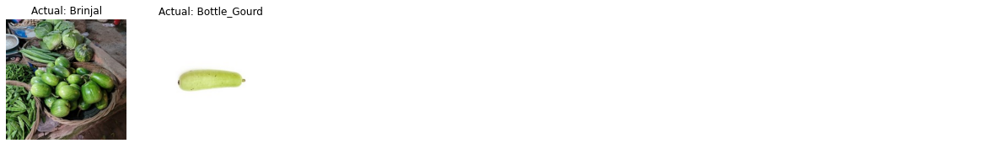

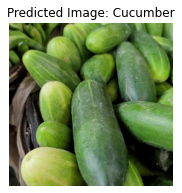

In [ ]:
# create another df for wrong classification of Cucumber
df = unfiltered_df_vgg16[(unfiltered_df_vgg16['actual_y'] != 'Cucumber') & (unfiltered_df_vgg16['pred'] == 'Cucumber')]

# Show pictures of wrongly predicted class for CNN model
wrong_prediction_plotter(shuffle(df)[:21], 'Cucumber')

# Test with unseen data

## Test models on unseen data (With hand)

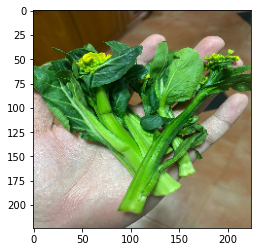

In [ ]:
# plot one image from test set as unseen data (not trained or validated before)

img_path='../data/dataset/test/chyesim_unseen2.jpg'
img_arr=cv2.imread(img_path)
img_arr = cv2.cvtColor(img_arr, cv2.COLOR_BGR2RGB)
img_arr=img_arr/255
img_arr=cv2.resize(img_arr, (224,224))
plt.imshow(img_arr)

Create dataframe of top 5 prediction probabilities for all models

In [ ]:
pd.DataFrame(CNN_model.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Cucumber,0.790595
Brinjal,0.086118
Bean,0.068204
Bottle_Gourd,0.045167
Capsicum,0.003728


In [ ]:
pd.DataFrame(mobilenet_test_pretrained.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Celery,0.574736
Kangkong,0.363619
Daun_Sup,0.058698
Parsley,0.002871
Sharp_Spinach,0.000063


In [ ]:
pd.DataFrame(mobilenet_unfrozen.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Celery,0.881094
Kangkong,0.037490
Daun_Sup,0.026216
Baby_Chyesim,0.017897
Broccoli,0.014403


In [ ]:
pd.DataFrame(VGG_model.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Celery,0.984015
Kangkong,0.011716
Bean,0.003495
Sharp_Spinach,0.000388
Daun_Sup,0.000224


The model is trained with anything we feed into the dataset, as the class: Celery was mainly trained with me holding on to the celery, the model captures it as the main feature for celery hence, the hand features overrules the main features of the Chyesim itself.

Also, we see that chyesim was predicted with a low prediction score only for the mobilenet_unfrozen. Lets try without the hands

## Test models on unseen data (Without hands)

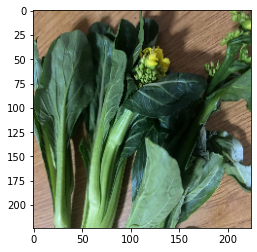

In [ ]:
# plt image without hands 

img_path='../data/dataset/test/chyesim_unseen3.jpg'
img_arr=cv2.imread(img_path)
img_arr = cv2.cvtColor(img_arr, cv2.COLOR_BGR2RGB)
img_arr=img_arr/255
img_arr=cv2.resize(img_arr, (224,224))
plt.imshow(img_arr)


Create dataframe with top 5 prediction probabilities from all models 


In [ ]:
pd.DataFrame(CNN_model.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Broccoli,0.814435
Daun_Sup,0.178803
Bean,0.003258
Kailan,0.001751
Pumpkin,0.000991


In [ ]:
pd.DataFrame(mobilenet_test_pretrained.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Kangkong,0.730621
Celery,0.260532
Daun_Sup,0.006405
Cabbage,0.001765
Baby_Chyesim,0.000488


In [ ]:
pd.DataFrame(mobilenet_unfrozen.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Baby_Chyesim,0.849310
Cabbage,0.111643
Cauliflower,0.029376
Parsley,0.004355
Kangkong,0.001680


In [ ]:
pd.DataFrame(VGG_model.predict(img_arr.reshape(1,224,224,3)).reshape(22,1),classes).rename(columns = {0: 'Probability'}).sort_values(by = 'Probability', ascending = False).head(5)

,Probability
Cabbage,9.930378e-01
Cauliflower,6.699700e-03
Radish,2.624568e-04
Carrot,9.605598e-08
Sharp_Spinach,1.350266e-09


We can see that only mobileNet completely re-trained version was able to pick up the vegetable correctly after the hand was removed. 

# Explore Feature maps in models

**Feature map: Complete Retrained MobileNetV2**

In [ ]:
mobilenet_unfrozen.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
____________________________________________________________________________________________

Zooming into spinach

c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: divide by zero encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


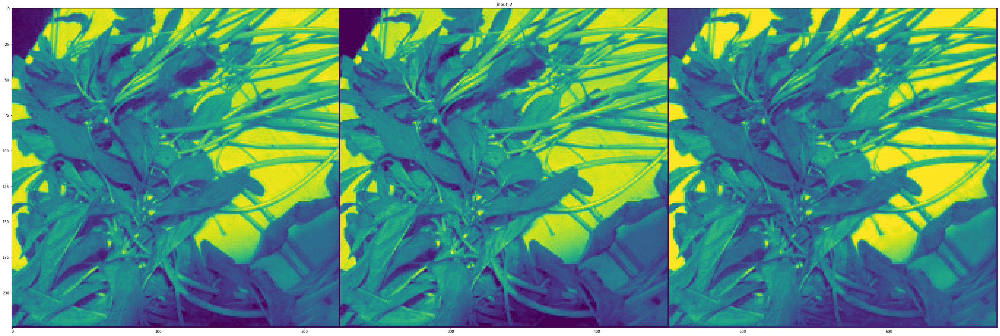

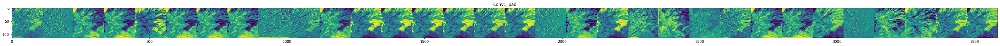

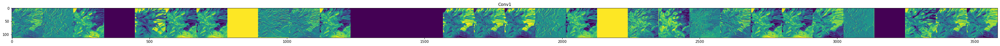

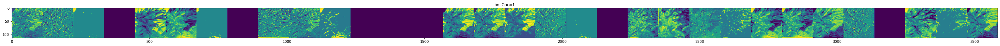

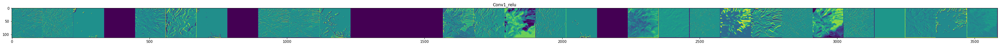

...

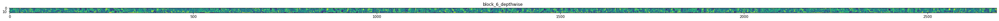

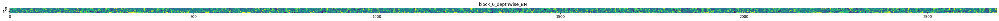

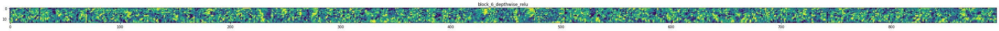

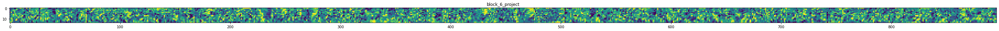

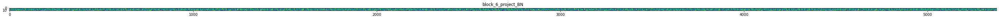

In [48]:
plot_feature_maps('../data/dataset_unbalanced/val/Sharp_Spinach\IMG_0004.JPG', mobilenet_unfrozen, ['input_2', 'Conv1', 'expanded','block_1_', 'block_6_'], 50., 'viridis')

Zooming into Kailan

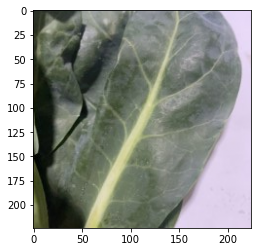

In [ ]:
img_path='../data/dataset/val/Kailan//kailan (968).JPG'
img_arr=cv2.imread(img_path)
img_arr = cv2.cvtColor(img_arr, cv2.COLOR_BGR2RGB)
img_arr=img_arr/255
img_arr=cv2.resize(img_arr, (224,224))
plt.imshow(img_arr)


c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: divide by zero encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


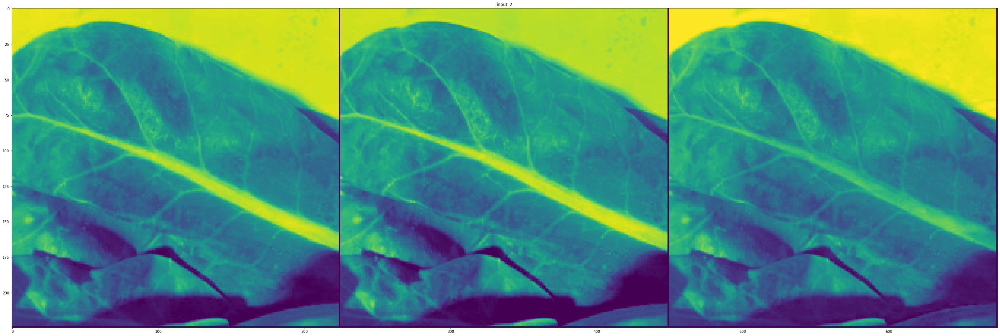

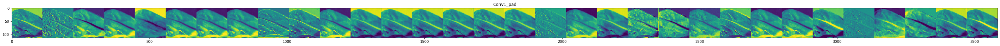

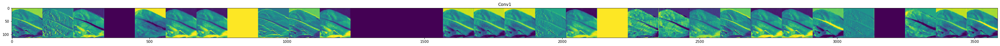

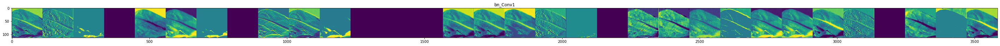

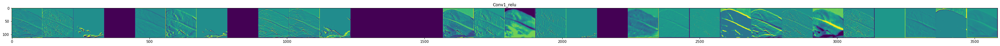

...

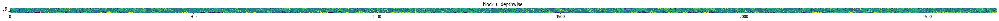

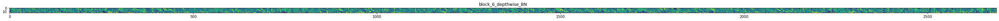

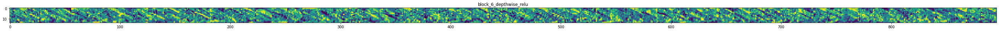

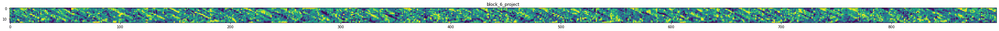

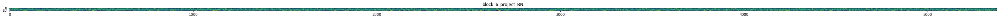

In [47]:
plot_feature_maps('../data/dataset/val/Kailan//kailan (968).JPG', mobilenet_unfrozen, ['input_2', 'Conv1', 'expanded','block_1_', 'block_6_'], 50., 'viridis')

Zooming into Coriander


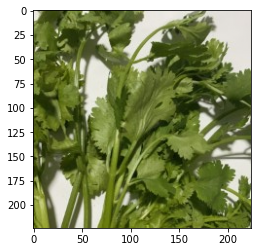

In [ ]:
img_path='../data/dataset/val/Coriander/coriander (1725).JPG'
img_arr=cv2.imread(img_path)
img_arr = cv2.cvtColor(img_arr, cv2.COLOR_BGR2RGB)
img_arr=img_arr/255
img_arr=cv2.resize(img_arr, (224,224))
plt.imshow(img_arr)


c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: divide by zero encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


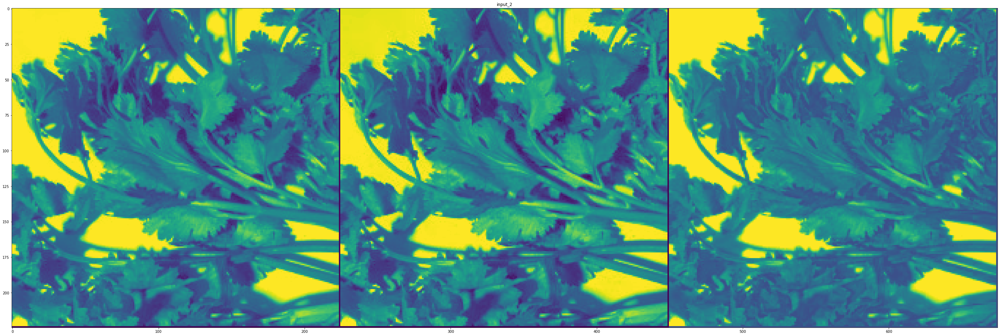

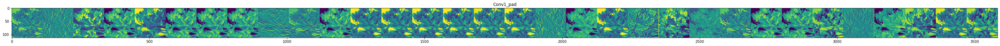

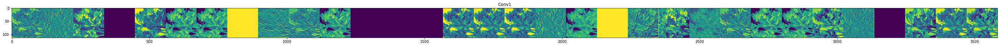

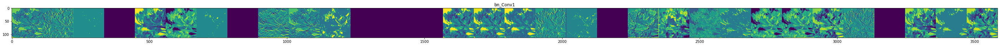

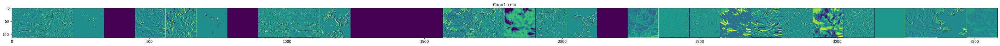

...

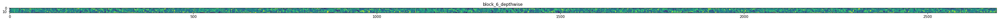

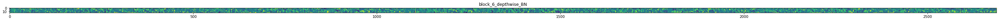

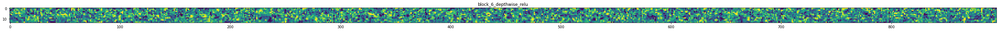

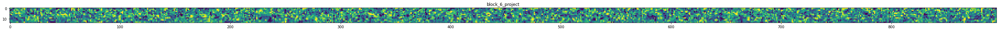

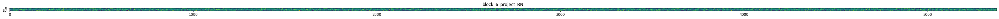

In [49]:
plot_feature_maps('../data/dataset/val/Coriander/coriander (1725).JPG', mobilenet_unfrozen, ['input_2', 'Conv1', 'expanded','block_1_', 'block_6_'], 50., 'viridis')

From the convolutions, we can see tha the model takes in leafy venations, texture, edges, and overall shape

## Exploring first convolution layer of MobileNetv2 with pre-trained weights vs Fully Unfrozen and retrained 

Showing feature map for pre-trained weights first 

c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: divide by zero encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in true_divide


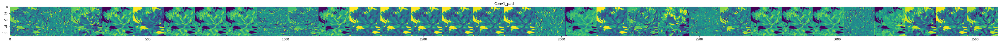

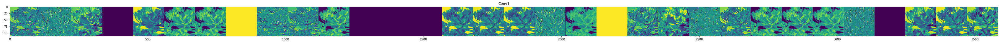

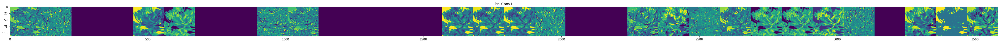

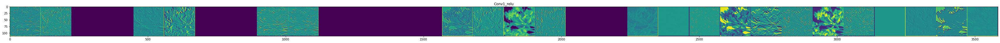

In [51]:
plot_feature_maps('../data/dataset/val/Coriander/coriander (1725).JPG', mobilenet_test_pretrained, ['Conv1'], 60., 'viridis')

Showing feature map captured by MobilenetV2 unfrozen and completed retrained 

c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: divide by zero encountered in true_divide
c:\Users\Admin\.conda\envs\dsi27tf\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in true_divide


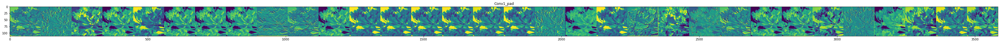

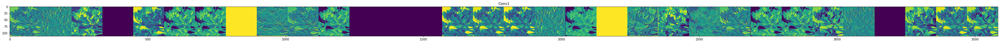

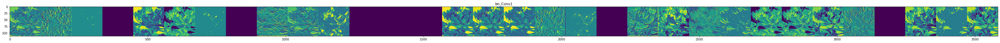

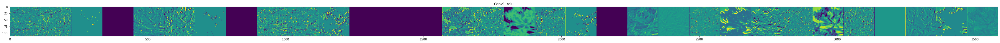

In [52]:
plot_feature_maps('../data/dataset/val/Coriander/coriander (1725).JPG', mobilenet_unfrozen, ['Conv1'], 60., 'viridis')

We can see that the mobilenetv2 complete retrained has a better convolution in terms of extracting more features so that further hidden layers are able to use these details for better classifciation. The highlights of the ends of the leaves were identified as compared to the one with pre-trained weights. 

# Conclusions & Recommendations

To have a good image classifier, it is very crucial we do proper data cleaning, including taking the right photos and ensuring only features of the vegetables and do not introduce too much variables that may seem important to the model, for example including too much of the hand while taking the photos. In global context, when we are dealing with image gathering through cloud or online spaces, we have to be mindful of filtering away pictures that has incriminating features like the label names it self,ie. taking pictures of cabbages with the background indicating labels: 'Cabbage'. 

Also, retraining models may consist a few iterations. It helps when we better understand the model we pick for transfer learning as not all models are good for our specific use cases, like vegetables. We may need look at the pre-trained images used for the model, and understand the features captured. We also have to consider the memory usage if we are thinking of using these models in our phones. 

For deployability, this mobilenetv2 is a perfect model to be used in mobile phones given the low-memory requirement to process images. Phones will not lag out while processing the image and generation of prediction will be fast. 